<a href="https://colab.research.google.com/github/xxMegaPVDxx/DeepPiCar/blob/master/Part_6_Deep_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Training a Raspberry Pi to Detect Traffic Signs and People in Real Time

Đây là hướng dẫn dựa trên sự xuất sắc của Chengwei Tutorial and Colab Notebook trên ["How to train an object detection model easy for free"](https://www.dlology.com/blog/how-to-train-an-object-detection-model-easy-for-free/).   Điểm mấu chốt trong hướng dẫn của anh ấy là tôi cần chạy mô hình của mình trên Raspberry Pi với nguồn cấp dữ liệu video trực tiếp. Vì Raspberry Pi khá hạn chế về sức mạnh CPU và chỉ có thể chạy phát hiện đối tượng với 1-2 FPS (frames per sec), Tôi đã mua thiết bị giá $75 mới phát hành của Google [EdgeTPU USB Accelarator](https://coral.withgoogle.com/products/accelerator), có thể phát hiện các đối tượng ở tốc độ 12 FPS, đủ để làm việc theo thời gian thực (realtime). Sau khi thực hiện học chuyển từ một trong các mô hình phát hiện đối tượng bằng hình ảnh của chính chúng ta, vài bước cuối cùng của Colab liên quan đến cách chuyển đổi mô hình đã đào tạo thành tệp mô hình có thể được sử dụng bởi Edge TPU, cụ thể. tệp cuối cùng là `mymodel_quantized_edgetpu.tflite`.  


![](https://cdn-images-1.medium.com/max/1000/1*_jABdMfUVcyPdi5b3zlfVg.jpeg)



In [1]:
# Install tensorflow version 2.2.0

#!pip install tensorflow==2.2.0
!pip install tensorflow==1.15.2

!pip install numpy==1.16.4

!pip install scikit-learn

!pip install tensorflow-datasets

     |████████████████████████████████| 110.5MB 85kB/s 
     |████████████████████████████████| 3.8MB 44.7MB/s 
     |████████████████████████████████| 512kB 45.2MB/s 
  Created wheel for gast: filename=gast-0.2.2-cp36-none-any.whl size=7540 sha256=50e72d6c75644d59c4f905cfac8888606e645655f1d819c2d97a40dbb70e1a0f
  Stored in directory: /root/.cache/pip/wheels/5c/2e/7e/a1d4d4fcebe6c381f378ce7743a3ced3699feb89bcfbdadadd
Successfully built gast
ERROR: tensorflow-probability 0.10.0 has requirement gast>=0.3.2, but you'll have gast 0.2.2 which is incompatible.
  Found existing installation: tensorboard 2.2.2
    Uninstalling tensorboard-2.2.2:
      Successfully uninstalled tensorboard-2.2.2
  Found existing installation: tensorflow-estimator 2.2.0
    Uninstalling tensorflow-estimator-2.2.0:
      Successfully uninstalled tensorflow-estimator-2.2.0
  Found existing installation: gast 0.3.3
    Uninstalling gast-0.3.3:
      Successfully uninstalled gast-0.3.3
  Found existing installation: 

In [1]:
# To determine which version you're using:
!pip show tensorflow
!pip show numpy

Name: tensorflow
Version: 1.15.2
Summary: TensorFlow is an open source machine learning framework for everyone.
Home-page: https://www.tensorflow.org/
Author: Google Inc.
Author-email: packages@tensorflow.org
License: Apache 2.0
Location: /usr/local/lib/python3.6/dist-packages
Requires: grpcio, absl-py, keras-applications, opt-einsum, numpy, google-pasta, keras-preprocessing, six, protobuf, tensorflow-estimator, termcolor, wrapt, astor, tensorboard, wheel, gast
Required-by: fancyimpute
Name: numpy
Version: 1.16.4
Summary: NumPy is the fundamental package for array computing with Python.
Home-page: https://www.numpy.org
Author: Travis E. Oliphant et al.
Author-email: None
License: BSD
Location: /usr/local/lib/python3.6/dist-packages
Requires: 
Required-by: yellowbrick, xgboost, xarray, wordcloud, umap-learn, torchvision, torchtext, torch, tifffile, thinc, Theano, tensorflow, tensorflow-probability, tensorflow-hub, tensorflow-datasets, tensorboard, tables, statsmodels, spacy, sklearn-pan

# Section 1: Mount Google drive
Gắn Google Drive của tôi và lưu mô hình các tệp đầu ra (`.ckpt`)  vào đó, để nó không bị xóa sổ khi máy ảo colab khởi động lại. Nó có thời gian chờ nhàn rỗi là 90 phút và thời gian sử dụng tối đa hàng ngày là 12 giờ.

Google sẽ yêu cầu mã xác thực khi bạn chạy mã sau, chỉ cần theo liên kết trong đầu ra và cho phép truy cập. Bạn có thể đặt `model_dir` ở bất cứ đâu trong ổ google của bạn.

In [2]:

from google.colab import drive
drive.mount('/content/gdrive')
model_dir = '/content/gdrive/My Drive/Colab Notebooks/TransferLearning/Training_2000_steps'
#!rm -rf '{model_dir}'
#os.makedirs(model_dir, exist_ok=True)
!ls -ltra '{model_dir}'/..

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive
total 8
drwx------ 2 root root 4096 May 13 16:43 Training
drwx------ 2 root root 4096 Jun  9 13:25 Training_2000_steps


# Section 2: Configs and Hyperparameters

Hỗ trợ nhiều mô hình khác nhau, bạn có thể tìm thấy nhiều mô hình được sàng lọc hơn từ [Tensorflow detection model zoo: COCO-trained models](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md#coco-trained-models), cũng như các tập tin cấu hình đường ống (pipline) của họ trong [object_detection/samples/configs/](https://github.com/tensorflow/models/tree/master/research/object_detection/samples/configs).

In [0]:
# If you forked the repository, you can replace the link.
repo_url = 'https://github.com/xxMegaPVDxx/Deepicar-Pi4'

# Number of training steps.

num_steps = 2000  # 200000

# Number of evaluation steps.
num_eval_steps = 50


# model configs are from Model Zoo github: 
# https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md#coco-trained-models
MODELS_CONFIG = {
    #http://download.tensorflow.org/models/object_detection/ssd_mobilenet_v1_quantized_300x300_coco14_sync_2018_07_18.tar.gz
    'ssd_mobilenet_v1_quantized': {
        'model_name': 'ssd_mobilenet_v1_quantized_300x300_coco14_sync_2018_07_18',
        'pipeline_file': 'ssd_mobilenet_v1_quantized_300x300_coco14_sync.config',
        'batch_size': 12
    },    
    'ssd_mobilenet_v2': {
        'model_name': 'ssd_mobilenet_v2_coco_2018_03_29',
        'pipeline_file': 'ssd_mobilenet_v2_coco.config',
        'batch_size': 12
    },
    #http://download.tensorflow.org/models/object_detection/ssd_mobilenet_v2_quantized_300x300_coco_2019_01_03.tar.gz
    'ssd_mobilenet_v2_quantized': {
        'model_name': 'ssd_mobilenet_v2_quantized_300x300_coco_2019_01_03',
        'pipeline_file': 'ssd_mobilenet_v2_quantized_300x300_coco.config',
        'batch_size': 12
    },
    'faster_rcnn_inception_v2': {
        'model_name': 'faster_rcnn_inception_v2_coco_2018_01_28',
        'pipeline_file': 'faster_rcnn_inception_v2_pets.config',
        'batch_size': 12
    },
    'rfcn_resnet101': {
        'model_name': 'rfcn_resnet101_coco_2018_01_28',
        'pipeline_file': 'rfcn_resnet101_pets.config',
        'batch_size': 12
    }
}

# Chọn mô hình bạn muốn sử dụng
# Select a model in `MODELS_CONFIG`.
# Note: for Edge TPU, you have to:
# 1) bắt đầu với một mô hình được sàng lọc từ vườn thú mô hình, chẳng hạn như trên 4
# 2) Phải là một mô hình lượng tử hóa, làm giảm đáng kể kích thước mô hình
selected_model = 'ssd_mobilenet_v2_quantized'

# Name of the object detection model to use.
MODEL = MODELS_CONFIG[selected_model]['model_name']

# Name of the pipline file in tensorflow object detection API.
pipeline_file = MODELS_CONFIG[selected_model]['pipeline_file']

# Training batch size fits in Colabe's Tesla K80 GPU memory for selected model.
batch_size = MODELS_CONFIG[selected_model]['batch_size']

# Section 3: Set up Training Environment

## Clone the `DeepPiCar` repository or your fork.

In [4]:
import os

%cd /content

repo_dir_path = os.path.abspath(os.path.join('.', os.path.basename(repo_url)))

!git clone {repo_url}
%cd {repo_dir_path}

print('Pull it so that we have the latest code/data')
!git pull

/content
Cloning into 'Deepicar-Pi4'...
remote: Enumerating objects: 1556, done.
remote: Total 1556 (delta 0), reused 0 (delta 0), pack-reused 1556
Receiving objects: 100% (1556/1556), 161.50 MiB | 28.66 MiB/s, done.
Resolving deltas: 100% (575/575), done.
/content/Deepicar-Pi4
Pull it so that we have the latest code/data
Already up to date.


## Install required packages

In [5]:
!apt-get install -qq protobuf-compiler python-pil python-lxml python-tk

!pip install -q Cython contextlib2 pillow lxml matplotlib

!pip install -q pycocotools


Selecting previously unselected package python-bs4.
(Reading database ... 144467 files and directories currently installed.)
Preparing to unpack .../0-python-bs4_4.6.0-1_all.deb ...
Unpacking python-bs4 (4.6.0-1) ...
Selecting previously unselected package python-pkg-resources.
Preparing to unpack .../1-python-pkg-resources_39.0.1-2_all.deb ...
Unpacking python-pkg-resources (39.0.1-2) ...
Selecting previously unselected package python-chardet.
Preparing to unpack .../2-python-chardet_3.0.4-1_all.deb ...
Unpacking python-chardet (3.0.4-1) ...
Selecting previously unselected package python-six.
Preparing to unpack .../3-python-six_1.11.0-2_all.deb ...
Unpacking python-six (1.11.0-2) ...
Selecting previously unselected package python-webencodings.
Preparing to unpack .../4-python-webencodings_0.5-2_all.deb ...
Unpacking python-webencodings (0.5-2) ...
Selecting previously unselected package python-html5lib.
Preparing to unpack .../5-python-html5lib_0.999999999-1_all.deb ...
Unpacking pyt

In [6]:
%cd /content
!git clone --quiet https://github.com/tensorflow/models.git

/content


In [7]:
!pip install tf_slim

     |████████████████████████████████| 358kB 4.6MB/s 


In [8]:
#@title
############################ Convert code from v1 to v2 ############################
# upgrade the .py files and copy all the other files to the outtree
!tf_upgrade_v2 \
    --intree models/ \
    --outtree models/ \
    --reportfile tree_report.txt



Streaming output truncated to the last 5000 lines.
INFO line 216:25: Changed tf.to_float call to tf.cast(..., dtype=tf.float32).
INFO line 219:6: tf.summary.image requires manual check. The TF 1.x summary API cannot be automatically migrated to TF 2.0, so symbols have been converted to tf.compat.v1.summary.* and must be migrated manually. Typical usage will only require changes to the summary writing logic, not to individual calls like scalar(). For examples of the new summary API, see the Effective TF 2.0 migration document or check the TF 2.0 TensorBoard tutorials.
INFO line 219:6: Renamed 'tf.summary.image' to 'tf.compat.v1.summary.image'
INFO line 222:26: Added keywords to args of function 'tf.confusion_matrix'
INFO line 222:26: Renamed 'tf.confusion_matrix' to 'tf.math.confusion_matrix'
INFO line 222:46: Added keywords to args of function 'tf.argmax'
INFO line 222:69: Added keywords to args of function 'tf.argmax'
INFO line 223:26: Changed tf.to_float call to tf.cast(..., dtype=tf

In [9]:
%cd /content/models/research
!protoc object_detection/protos/*.proto --python_out=.

import os
os.environ['PYTHONPATH'] += ':/content/models/research/:/content/models/research/slim/'

!python object_detection/builders/model_builder_test.py



/content/models/research
object_detection/protos/input_reader.proto: warning: Import object_detection/protos/image_resizer.proto but not used.


## Prepare `tfrecord` files

Sử dụng các tập lệnh sau để tạo các tệp `tfrecord`.

```

In [10]:
%cd /content/
!find . -iname generate_tfrecord.py

/content
./Deepicar-Pi4/models/object_detection/code/generate_tfrecord.py


In [15]:
%cd {repo_dir_path}/models/object_detection

# Convert train folder annotation xml files to a single csv file,
# generate the `label_map.pbtxt` file to `data/` directory as well.
!python code/xml_to_csv.py -i data/images/train4 -o data/annotations/train_labels.csv -l data/annotations

# Convert test folder annotation xml files to a single csv.
!python code/xml_to_csv.py -i data/images/train4 -o data/annotations/test_labels.csv

# Generate `train.record`
!python code/generate_tfrecord.py --csv_input=data/annotations/train_labels.csv --output_path=data/annotations/train.record --img_path=data/images/train4 --label_map data/annotations/label_map.pbtxt

# Generate `test.record`
!python code/generate_tfrecord.py --csv_input=data/annotations/test_labels.csv --output_path=data/annotations/test.record --img_path=data/images/train4 --label_map data/annotations/label_map.pbtxt

/content/Deepicar-Pi4/models/object_detection
Successfully converted xml to csv.
Generate `data/annotations/label_map.pbtxt`
Successfully converted xml to csv.
Successfully created the TFRecords: /content/Deepicar-Pi4/models/object_detection/data/annotations/train.record
Successfully created the TFRecords: /content/Deepicar-Pi4/models/object_detection/data/annotations/test.record


In [0]:
test_record_fname = repo_dir_path + '/models/object_detection/data/annotations/test.record'
train_record_fname = repo_dir_path + '/models/object_detection/data/annotations/train.record'
label_map_pbtxt_fname = repo_dir_path + '/models/object_detection/data/annotations/label_map.pbtxt'

In [17]:
%cd {repo_dir_path}/models/object_detection
!cat data/annotations/test_labels.csv

/content/Deepicar-Pi4/models/object_detection
filename,width,height,class,xmin,ymin,xmax,ymax
car_video_6_012.png,320,240,Red,274,36,292,68
car_video_6_012.png,320,240,Stop,203,25,213,36
car_video_2_001.png,320,240,limit 30,288,48,320,80
car_video_2_001.png,320,240,limit 50,226,29,241,43
car_video_10_002.png,320,240,limit 50,293,50,320,80
car_video_6_004.png,320,240,limit 50,251,35,277,63
car_video_2_004.png,320,240,limit 50,292,40,320,67
car_video_10_001.png,320,240,limit 50,257,43,281,69
car_video_1_013.png,320,240,Stop,173,34,195,57
car_video_9_016.png,320,240,limit 30,247,125,320,205
car_video_9_015.png,320,240,limit 30,211,70,253,115
car_video_8_004.png,320,240,limit 50,251,43,281,74
car_video_8_029.png,320,240,Blue,135,30,147,51
car_video_10_036.png,320,240,Stop,146,46,176,76
car_video_13_002.png,320,240,Blue,62,55,87,95
car_video_13_002.png,320,240,Stop,94,24,107,39
car_video_1_009.png,320,240,Stop,183,31,197,45
car_video_3_003.png,320,240,limit 50,249,37,271,61
car_video_1_001.

## Download base model

In [18]:
%cd /content/models/research

import os
import shutil
import glob
import urllib.request
import tarfile
MODEL_FILE = MODEL + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'
DEST_DIR = '/content/models/research/pretrained_model'

if not (os.path.exists(MODEL_FILE)):
    urllib.request.urlretrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)

tar = tarfile.open(MODEL_FILE)
tar.extractall()
tar.close()

os.remove(MODEL_FILE)
if (os.path.exists(DEST_DIR)):
    shutil.rmtree(DEST_DIR)
os.rename(MODEL, DEST_DIR)

/content/models/research


In [19]:
!echo {DEST_DIR}
!ls -alh {DEST_DIR}

/content/models/research/pretrained_model
total 204M
drwx------  2 303230 5000 4.0K Jan  4  2019 .
drwxr-xr-x 63 root   root 4.0K Jun  9 15:39 ..
-rw-------  1 303230 5000  93M Jan  4  2019 model.ckpt.data-00000-of-00001
-rw-------  1 303230 5000  68K Jan  4  2019 model.ckpt.index
-rw-------  1 303230 5000  20M Jan  4  2019 model.ckpt.meta
-rw-------  1 303230 5000 4.3K Jan  4  2019 pipeline.config
-rw-------  1 303230 5000  24M Jan  4  2019 tflite_graph.pb
-rw-------  1 303230 5000  68M Jan  4  2019 tflite_graph.pbtxt


In [20]:
fine_tune_checkpoint = os.path.join(DEST_DIR, "model.ckpt")
fine_tune_checkpoint

'/content/models/research/pretrained_model/model.ckpt'

# Section 4: Transfer Learning Training

## Configuring a Training Pipeline

In [0]:
import os
pipeline_fname = os.path.join('/content/models/research/object_detection/samples/configs/', pipeline_file)

assert os.path.isfile(pipeline_fname), '`{}` not exist'.format(pipeline_fname)

In [0]:
def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())

In [0]:
import re

# training pipeline file defines:
# - pretrain model path
# - the train/test sets
# - ID to Label mapping and number of classes
# - training batch size
# - epochs to trains
# - learning rate
# - etc

# note we just need to use a sample one, and make edits to it.

num_classes = get_num_classes(label_map_pbtxt_fname)
with open(pipeline_fname) as f:
    s = f.read()
with open(pipeline_fname, 'w') as f:
    
    # fine_tune_checkpoint: downloaded pre-trained model checkpoint path
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)
    
    # tfrecord files train and test, we created earlier with our training/test sets
    s = re.sub(
        '(input_path: ".*?)(train.record)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(val.record)(.*?")', 'input_path: "{}"'.format(test_record_fname), s)

    # label_map_path: ID to label file
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set training batch_size.
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps (Number of epochs to train)
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)
    
    # Set number of classes num_classes.
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)
    f.write(s)

In [24]:
!cat {label_map_pbtxt_fname}

item {
    id: 1
    name: 'Blue'
}

item {
    id: 2
    name: 'Red'
}

item {
    id: 3
    name: 'Stop'
}

item {
    id: 4
    name: 'limit 30'
}

item {
    id: 5
    name: 'limit 50'
}

In [25]:
# look for num_classes: 6, since we have 5 different road signs and 1 person type (total of 6 types) 
!cat {pipeline_fname}

# Quantized trained SSD with Mobilenet v2 on MSCOCO Dataset.
# Users should configure the fine_tune_checkpoint field in the train config as
# well as the label_map_path and input_path fields in the train_input_reader and
# eval_input_reader. Search for "PATH_TO_BE_CONFIGURED" to find the fields that
# should be configured.

model {
  ssd {
    num_classes: 5
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    anchor_generator {
      ssd_anchor_generator {
        num_layers: 6
        min_scale: 0.2
        max_scale: 0.95
        aspect_ratios: 1.0
        aspect_ratios: 2.0
        aspe

## Run Tensorboard(Optional)

In [26]:
!wget https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
!unzip -o ngrok-stable-linux-amd64.zip

--2020-06-09 15:40:09--  https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
Resolving bin.equinox.io (bin.equinox.io)... 34.205.198.58, 3.223.118.45, 3.220.228.61, ...
Connecting to bin.equinox.io (bin.equinox.io)|34.205.198.58|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13773305 (13M) [application/octet-stream]
Saving to: ‘ngrok-stable-linux-amd64.zip’

ngrok-stable-linux- 100%[===================>]  13.13M  16.5MB/s    in 0.8s    

2020-06-09 15:40:10 (16.5 MB/s) - ‘ngrok-stable-linux-amd64.zip’ saved [13773305/13773305]

Archive:  ngrok-stable-linux-amd64.zip
  inflating: ngrok                   


In [0]:
LOG_DIR = model_dir
get_ipython().system_raw(
    'tensorboard --logdir "{}" --host 0.0.0.0 --port 6006 &'
    .format(LOG_DIR)
)

In [0]:
get_ipython().system_raw('./ngrok http 6006 &')

### Get Tensorboard link

In [29]:
! curl -s http://localhost:4040/api/tunnels | python3 -c \
    "import sys, json; print(json.load(sys.stdin)['tunnels'][0]['public_url'])"

https://73ba65356866.ngrok.io


## Train the model

Now all inputs are set up, just train the model.   This process may take a few hours.   Since we are saving the model training results (model.ckpt-* files) in our google drive (a persistent storage that will survice the restart of our colab VM instance), we can safely leave and return a few hours later. 

In [0]:
#################### SEND ALERT EMAIL AT FINISH WITH GMAIL #####################
# To send email from Python from your google account, MUST 
# 1) Enable less secure app
# https://myaccount.google.com/lesssecureapps
# 2) Disable Unlock Capcha
# https://accounts.google.com/b/0/DisplayUnlockCaptcha

import smtplib

def SendEmail(msg):
    with open('/content/gdrive/My Drive/Colab Notebooks/pw.txt') as file:
        data = file.readlines()
        
    gmail_user = 'phanvandau1510@gmail.com'  
    gmail_password = data[0]


    sent_from = gmail_user  
    to = ['dau.pv150922@sis.hust.edu.vn']  
    subject = msg  
    body = '%s\n\n- Dau' % msg

    email_text = \
"""From: %s
To: %s
Subject: %s

%s
""" % (sent_from, ", ".join(to), subject, body)

    server = smtplib.SMTP("smtp.gmail.com", 587)
    server.ehlo()
    server.starttls()
    server.login(gmail_user, gmail_password)
    server.sendmail(sent_from, to, email_text)
    server.quit()

    print(f'Email: \n{email_text}')
    

In [35]:
#%cd /content/models/research
import os
os.environ['PYTHONPATH'] += ':/content/models/research/:/content/models/research/slim/'
num_steps = 2000
SendEmail("Colab train started")
!python /content/models/research/object_detection/model_main.py \
    --pipeline_config_path={pipeline_fname} \
    --model_dir='{model_dir}' \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --num_eval_steps={num_eval_steps}
SendEmail("Colab train finished")

Email: 
From: phanvandau1510@gmail.com
To: dau.pv150922@sis.hust.edu.vn
Subject: Colab train started

Colab train started

- Dau

W0609 21:08:12.235362 140673060165504 model_lib.py:717] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting train_steps: 2000
I0609 21:08:12.235648 140673060165504 config_util.py:523] Maybe overwriting train_steps: 2000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0609 21:08:12.235766 140673060165504 config_util.py:523] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: 1
I0609 21:08:12.235872 140673060165504 config_util.py:523] Maybe overwriting sample_1_of_n_eval_examples: 1
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0609 21:08:12.235972 140673060165504 config_util.py:523] Maybe overwriting eval_num_epochs: 1
INFO:tensorflow:Maybe overwriting load_pretrained: True
I0609 21:08:12.236057 140673060165504 config_util.py:523] Maybe overwriting load_pre

In [36]:
!ls -ltra '{model_dir}'

total 535257
-rw------- 1 root root 31336667 Jun  9 15:42 graph.pbtxt
drwx------ 2 root root     4096 Jun  9 15:53 eval_0
-rw------- 1 root root    68787 Jun  9 20:34 model.ckpt-1801.index
-rw------- 1 root root 74975648 Jun  9 20:34 model.ckpt-1801.data-00000-of-00001
-rw------- 1 root root 16443371 Jun  9 20:35 model.ckpt-1801.meta
-rw------- 1 root root    68787 Jun  9 20:45 model.ckpt-1865.index
-rw------- 1 root root 74975648 Jun  9 20:45 model.ckpt-1865.data-00000-of-00001
-rw------- 1 root root 16443371 Jun  9 20:45 model.ckpt-1865.meta
-rw------- 1 root root    68787 Jun  9 20:55 model.ckpt-1929.index
-rw------- 1 root root 74975648 Jun  9 20:55 model.ckpt-1929.data-00000-of-00001
-rw------- 1 root root 16443371 Jun  9 20:55 model.ckpt-1929.meta
-rw------- 1 root root    68787 Jun  9 21:05 model.ckpt-1990.index
-rw------- 1 root root 74975648 Jun  9 21:05 model.ckpt-1990.data-00000-of-00001
-rw------- 1 root root 16443371 Jun  9 21:05 model.ckpt-1990.meta
-rw------- 1 root root

# Section 5: Save and Convert Model Output

## Exporting a Trained Inference Graph
Once your training job is complete, you need to extract the newly trained inference graph, which will be later used to perform the object detection. This can be done as follows:

In [0]:
import os
import re
import numpy as np

output_directory = '%s/fine_tuned_model' % model_dir
os.makedirs(output_directory, exist_ok=True)

In [38]:
lst = os.listdir(model_dir)
# find the last model checkpoint file, i.e. model.ckpt-1000.meta
lst = [l for l in lst if 'model.ckpt-' in l and '.meta' in l]
steps=np.array([int(re.findall('\d+', l)[0]) for l in lst])
last_model = lst[steps.argmax()].replace('.meta', '')

last_model_path = os.path.join(model_dir, last_model)
print(last_model_path)


/content/gdrive/My Drive/Colab Notebooks/TransferLearning/Training_2000_steps/model.ckpt-2000


In [39]:
!echo creates the frozen inference graph in fine_tune_model
# there is an "Incomplete shape" message.  but we can safely ignore that. 
!python /content/models/research/object_detection/export_inference_graph.py \
    --input_type=image_tensor \
    --pipeline_config_path={pipeline_fname} \
    --output_directory='{output_directory}' \
    --trained_checkpoint_prefix='{last_model_path}'

creates the frozen inference graph in fine_tune_model
Instructions for updating:
Please use `layer.__call__` method instead.
W0609 22:16:12.510535 140161454303104 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tf_slim/layers/layers.py:1089: Layer.apply (from tensorflow.python.keras.engine.base_layer) is deprecated and will be removed in a future version.
Instructions for updating:
Please use `layer.__call__` method instead.
INFO:tensorflow:depth of additional conv before box predictor: 0
I0609 22:16:15.214517 140161454303104 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv before box predictor: 0
I0609 22:16:15.395166 140161454303104 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv before box predictor: 0
I0609 22:16:15.442028 140161454303104 convolutional_box_predictor.py:156] depth of additional conv before box pred

In [40]:
# https://medium.com/tensorflow/training-and-serving-a-realtime-mobile-object-detector-in-30-minutes-with-cloud-tpus-b78971cf1193
# create the tensorflow lite graph
!python /content/models/research/object_detection/export_tflite_ssd_graph.py \
    --pipeline_config_path={pipeline_fname} \
    --trained_checkpoint_prefix='{last_model_path}' \
    --output_directory='{output_directory}' \
    --add_postprocessing_op=true

Instructions for updating:
Please use `layer.__call__` method instead.
W0609 22:17:36.413633 140606763423616 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tf_slim/layers/layers.py:1089: Layer.apply (from tensorflow.python.keras.engine.base_layer) is deprecated and will be removed in a future version.
Instructions for updating:
Please use `layer.__call__` method instead.
INFO:tensorflow:depth of additional conv before box predictor: 0
I0609 22:17:38.846868 140606763423616 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv before box predictor: 0
I0609 22:17:38.894771 140606763423616 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv before box predictor: 0
I0609 22:17:38.931349 140606763423616 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv befo

In [41]:
!echo "CONVERTING frozen graph to quantized TF Lite file..."
!tflite_convert \
  --output_file='{output_directory}/road_signs_quantized.tflite' \
  --graph_def_file='{output_directory}/tflite_graph.pb' \
  --inference_type=QUANTIZED_UINT8 \
  --input_arrays='normalized_input_image_tensor' \
  --output_arrays='TFLite_Detection_PostProcess,TFLite_Detection_PostProcess:1,TFLite_Detection_PostProcess:2,TFLite_Detection_PostProcess:3' \
  --mean_values=128 \
  --std_dev_values=128 \
  --input_shapes=1,300,300,3 \
  --change_concat_input_ranges=false \
  --allow_nudging_weights_to_use_fast_gemm_kernel=true \
  --allow_custom_ops

CONVERTING frozen graph to quantized TF Lite file...
2020-06-09 22:17:56.399050: I tensorflow/core/platform/cpu_feature_guard.cc:142] Your CPU supports instructions that this TensorFlow binary was not compiled to use: AVX2 FMA
2020-06-09 22:17:56.403191: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 2200000000 Hz
2020-06-09 22:17:56.403412: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x3292a00 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2020-06-09 22:17:56.403445: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Host, Default Version


In [42]:
!echo "CONVERTING frozen graph to unquantized TF Lite file..."
!tflite_convert \
  --output_file='{output_directory}/road_signs_float.tflite' \
  --graph_def_file='{output_directory}/tflite_graph.pb' \
  --input_arrays='normalized_input_image_tensor' \
  --output_arrays='TFLite_Detection_PostProcess,TFLite_Detection_PostProcess:1,TFLite_Detection_PostProcess:2,TFLite_Detection_PostProcess:3' \
  --mean_values=128 \
  --std_dev_values=128 \
  --input_shapes=1,300,300,3 \
  --change_concat_input_ranges=false \
  --allow_nudging_weights_to_use_fast_gemm_kernel=true \
  --allow_custom_ops 


CONVERTING frozen graph to unquantized TF Lite file...
2020-06-09 22:18:08.956580: I tensorflow/core/platform/cpu_feature_guard.cc:142] Your CPU supports instructions that this TensorFlow binary was not compiled to use: AVX2 FMA
2020-06-09 22:18:08.960790: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 2200000000 Hz
2020-06-09 22:18:08.961052: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x26aaa00 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2020-06-09 22:18:08.961086: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Host, Default Version


In [43]:
print(output_directory)
!ls -ltra '{output_directory}'
#pb_fname = os.path.join(os.path.abspath(output_directory), "frozen_inference_graph.pb") # this is main one
pb_fname = os.path.join(os.path.abspath(output_directory), "frozen_inference_graph.pb")  # this is tflite graph
!cp '{label_map_pbtxt_fname}' '{output_directory}'

/content/gdrive/My Drive/Colab Notebooks/TransferLearning/Training_2000_steps/fine_tuned_model
total 134468
-rw------- 1 root root    23543 Jun  9 22:16 model.ckpt.index
-rw------- 1 root root 18857216 Jun  9 22:16 model.ckpt.data-00000-of-00001
-rw------- 1 root root       77 Jun  9 22:16 checkpoint
-rw------- 1 root root  2204022 Jun  9 22:16 model.ckpt.meta
-rw------- 1 root root 19734989 Jun  9 22:16 frozen_inference_graph.pb
drwx------ 3 root root     4096 Jun  9 22:16 saved_model
-rw------- 1 root root     4307 Jun  9 22:16 pipeline.config
-rw------- 1 root root 19342722 Jun  9 22:17 tflite_graph.pb
-rw------- 1 root root 54017201 Jun  9 22:17 tflite_graph.pbtxt
-rw------- 1 root root  4777024 Jun  9 22:18 road_signs_quantized.tflite
-rw------- 1 root root 18727104 Jun  9 22:18 road_signs_float.tflite


## Run inference test
Test with images in repository `object_detection/data/images/test` directory.

In [50]:
import os
import glob

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = pb_fname
print(PATH_TO_CKPT)

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = label_map_pbtxt_fname

# If you want to test the code with your images, just add images files to the PATH_TO_TEST_IMAGES_DIR.
PATH_TO_TEST_IMAGES_DIR =  os.path.join(repo_dir_path, "models/object_detection/data/images/train4")

assert os.path.isfile(pb_fname)
assert os.path.isfile(PATH_TO_LABELS)
TEST_IMAGE_PATHS = glob.glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, "*.png"))
assert len(TEST_IMAGE_PATHS) > 0, 'No image found in `{}`.'.format(PATH_TO_TEST_IMAGES_DIR)
print(TEST_IMAGE_PATHS)

/content/gdrive/My Drive/Colab Notebooks/TransferLearning/Training_2000_steps/fine_tuned_model/frozen_inference_graph.pb
['/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_7_003.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_1_005.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_9_016.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_8_016.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_10_037.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_2_004.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_6_022.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_9_031.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_10_002.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_6_020.pn

In [51]:
%cd /content/models/research/object_detection

import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")
from object_detection.utils import ops as utils_ops


# This is needed to display the images.
%matplotlib inline


from object_detection.utils import label_map_util

from object_detection.utils import visualization_utils as vis_util


detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')


label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(
    label_map, max_num_classes=num_classes, use_display_name=True)
category_index = label_map_util.create_category_index(categories)


def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)


def run_inference_for_single_image(image, graph):
    with graph.as_default():
        with tf.Session() as sess:
            # Get handles to input and output tensors
            ops = tf.get_default_graph().get_operations()
            all_tensor_names = {
                output.name for op in ops for output in op.outputs}
            tensor_dict = {}
            for key in [
                'num_detections', 'detection_boxes', 'detection_scores',
                'detection_classes', 'detection_masks'
            ]:
                tensor_name = key + ':0'
                if tensor_name in all_tensor_names:
                    tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
                        tensor_name)
            if 'detection_masks' in tensor_dict:
                # The following processing is only for single image
                detection_boxes = tf.squeeze(
                    tensor_dict['detection_boxes'], [0])
                detection_masks = tf.squeeze(
                    tensor_dict['detection_masks'], [0])
                # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
                real_num_detection = tf.cast(
                    tensor_dict['num_detections'][0], tf.int32)
                detection_boxes = tf.slice(detection_boxes, [0, 0], [
                                           real_num_detection, -1])
                detection_masks = tf.slice(detection_masks, [0, 0, 0], [
                                           real_num_detection, -1, -1])
                detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
                    detection_masks, detection_boxes, image.shape[0], image.shape[1])
                detection_masks_reframed = tf.cast(
                    tf.greater(detection_masks_reframed, 0.5), tf.uint8)
                # Follow the convention by adding back the batch dimension
                tensor_dict['detection_masks'] = tf.expand_dims(
                    detection_masks_reframed, 0)
            image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

            # Run inference
            output_dict = sess.run(tensor_dict,
                                   feed_dict={image_tensor: np.expand_dims(image, 0)})

            # all outputs are float32 numpy arrays, so convert types as appropriate
            output_dict['num_detections'] = int(
                output_dict['num_detections'][0])
            output_dict['detection_classes'] = output_dict[
                'detection_classes'][0].astype(np.uint8)
            output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
            output_dict['detection_scores'] = output_dict['detection_scores'][0]
            if 'detection_masks' in output_dict:
                output_dict['detection_masks'] = output_dict['detection_masks'][0]
    return output_dict



/content/models/research/object_detection


Running inferences on ['/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_7_003.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_1_005.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_9_016.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_8_016.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_10_037.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_2_004.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_6_022.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_9_031.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_10_002.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_6_020.png', '/content/Deepicar-Pi4/models/object_detection/data/images/train4/car_video_13_002.png', '/cont

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


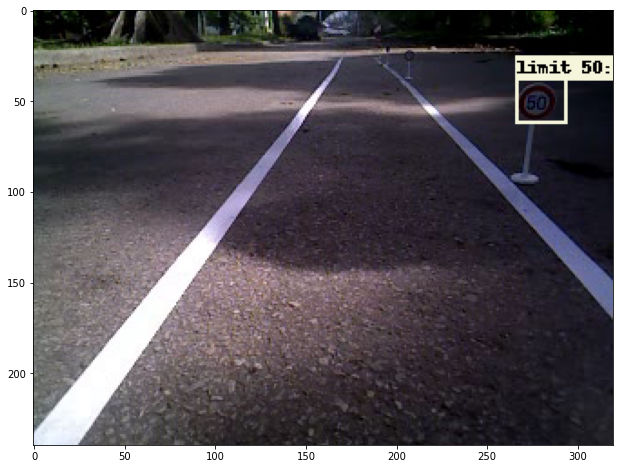

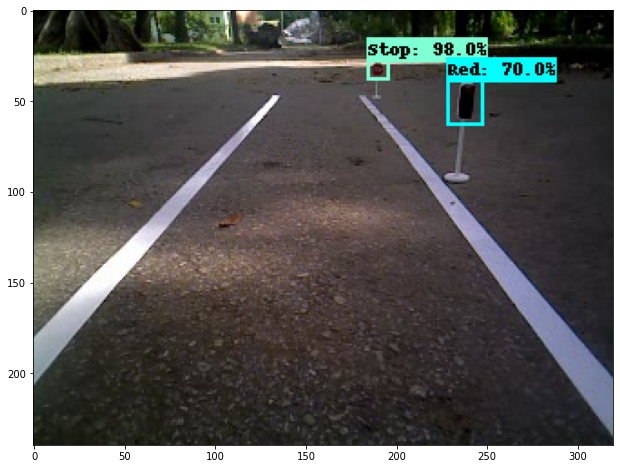

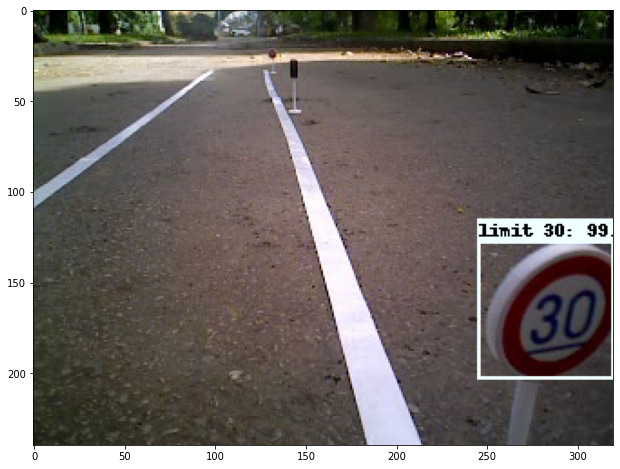

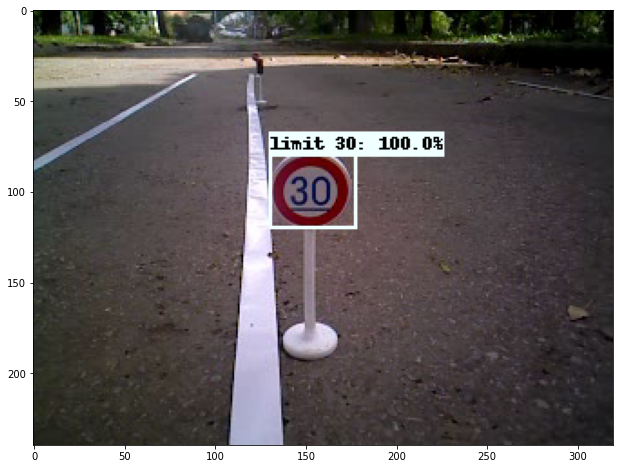

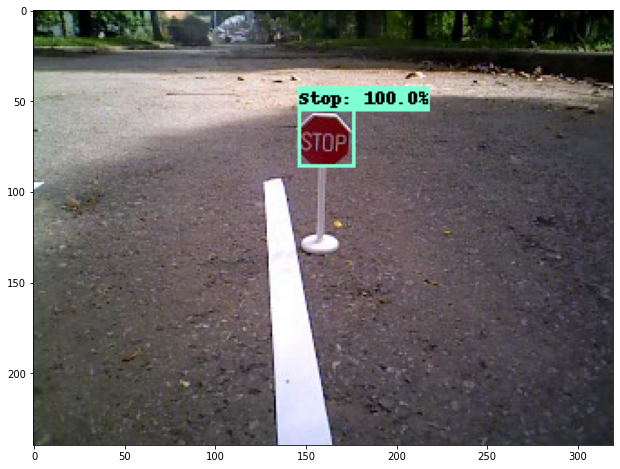

...

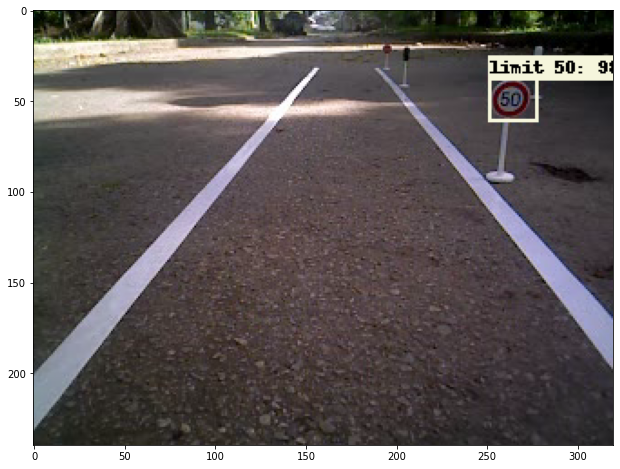

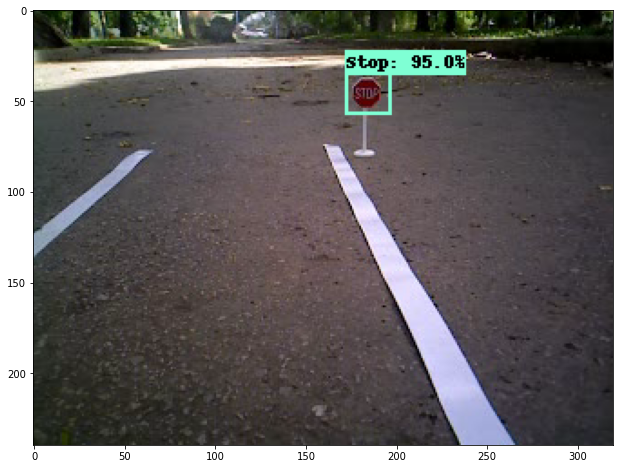

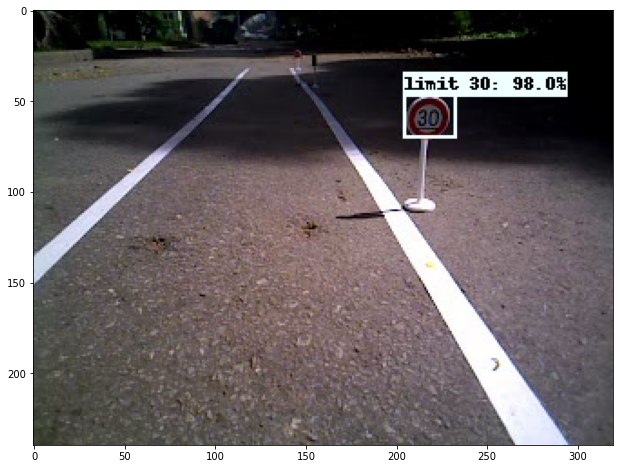

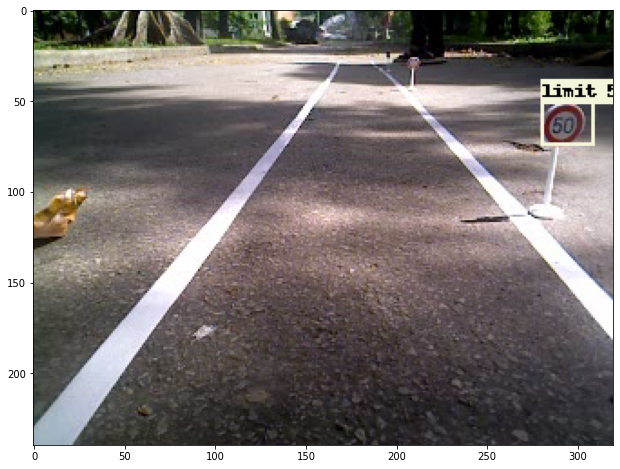

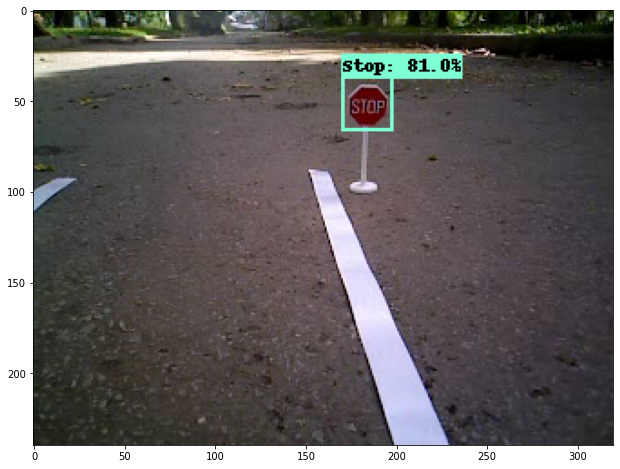

In [53]:
# running inferences.  This should show images with bounding boxes
%matplotlib inline

print('Running inferences on %s' % TEST_IMAGE_PATHS)
for image_path in TEST_IMAGE_PATHS:
    image = Image.open(image_path)
    # the array based representation of the image will be used later in order to prepare the
    # result image with boxes and labels on it.
    image_np = load_image_into_numpy_array(image)
    # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
    image_np_expanded = np.expand_dims(image_np, axis=0)
    # Actual detection.
    output_dict = run_inference_for_single_image(image_np, detection_graph)
    # Visualization of the results of a detection.
    vis_util.visualize_boxes_and_labels_on_image_array(
        image_np,
        output_dict['detection_boxes'],
        output_dict['detection_classes'],
        output_dict['detection_scores'],
        category_index,
        instance_masks=output_dict.get('detection_masks'),
        use_normalized_coordinates=True,
        line_thickness=2)
    plt.figure(figsize=IMAGE_SIZE)
    plt.imshow(image_np)

## Convert to Edge TPU's tflite Format  
The only known way, at time of writing (April 2019), is to download the below quantized tflite file from above, and use [Google's web compiler](https://coral.withgoogle.com/web-compiler/) to convert to Edge TPU's tflite format.   Unfortunately, this step has to be done by hand, and NOT via a script.  

Here are the requirements of Edge TPU web compiler.  If you have followed the above steps closely, you have met these requirements.

- Tensor parameters are quantized (8-bit fixed-point numbers). You must use quantization-aware training (post-training quantization is not supported).   (this is why we are using `ssd_mobilenet_v2_quantized` base model and not the  `ssd_mobilenet_v2` base model   
- Tensor sizes are constant at compile-time (no dynamic sizes).
- Model parameters (such as bias tensors) are constant at compile-time.
- Tensors are either 1-, 2-, or 3-dimensional. If a tensor has more than 3 dimensions, then only the 3 innermost dimensions may have a size greater than 1.
- The model uses only the operations supported by the Edge TPU 

In [54]:
# download this file from google drive.
!ls -lt '/content/gdrive/My Drive/Colab Notebooks/TransferLearning/Training/fine_tuned_model/road_signs_quantized.tflite'

ls: cannot access '/content/gdrive/My Drive/Colab Notebooks/TransferLearning/Training/fine_tuned_model/road_signs_quantized.tflite': No such file or directory


Wait for about 1-2 minutes for compilation to finish.  And we can download the model file as `road_signs_quantized_edgetpu.tflite`.  This is the file you need to copy to raspberry pi with TPU to run object detection.

We are all done with colab notebook training, now time to switch back to raspberry pi, and run `~/DeepPiCar/models/object_detection/code/object_detection_usb.py`.  You should see a video feed where road sign and persons are boxed with confidence level around them.  

```bash
# make sure the the road_signs_quantized_edgetpu.tflite is in the right directory in your pi
pi@raspberrypi:~/DeepPiCar/models/object_detection/data/model_result $ ls -ltr
total 10040
-rw-r--r-- 1 pi pi      97 Apr 15 01:01 road_sign_labels.txt
-rw-r--r-- 1 pi pi 4793504 Apr 16 15:49 road_signs_quantized.tflite
-rw-r--r-- 1 pi pi 5478080 Apr 16 15:49 road_signs_quantized_edgetpu.tflite

pi@raspberrypi:~/DeepPiCar/models/object_detection $ python3 code/object_detection_usb.py

------
2019-04-16 16:22:28.489224: 13.49 FPS, 74.12ms total, 70.84ms in tf 
Green Traffic Light, 80% [[240.61578751 131.68985367]
 [287.21975327 195.79172134]] 60.42ms
Stop Sign, 44% [[  0.         305.1651001 ]
 [180.84949493 409.32563782]] 60.42ms

------
2019-04-16 16:22:28.618309: 14.83 FPS, 67.44ms total, 60.42ms in tf 
Person, 89% [[505.6583786  279.52325821]
 [530.85933685 360.0169754 ]] 62.54ms
Green Traffic Light, 72% [[237.96649933 130.58757782]
 [283.52127075 203.24180603]] 62.54ms
Red Traffic Light, 62% [[283.23583603 169.27398682]
 [330.91316223 269.20692444]] 62.54ms
Stop Sign, 56% [[ 51.01628304 165.80377579]
 [101.48646355 227.05183029]] 62.54ms
Person, 44% [[396.8661499  298.65327835]
 [468.4034729  422.04421997]] 62.54ms
------

```

# Section 6: Last Words on this Project

Of course, depending many factors, not all objects in the video frame will be identified.  This is the chance to improve your model.   Try to train longer, or train with more labeled images, or augment your existing images with different zooms/rotations/contrast/lighting.  In my case, I started with one camera, which was somewhat fuzzy, and precision low.  When I switched to a HD camera, the model precision was significantly better.   This was just another way.

It is awesome that for just over $100 in hardware, we can do real time object detection at home.   Moreover, thanks to Google, all you need is a browser to train this huge model!  Having fun with your own raspberry pi object detection projects!  